# Introduction

This notebook will walk you over using different tools to process data products for the Lunasynth project. Some tools are open-source like gdal, and some other tools have been created for this project. This document covers two main types of files
- Digital Elevation Maps (DEM) in the form of GeoTIFF files
- 3D models in the form of ply files

## Dependencies

- [GDAL](https://gdal.org/) for any gdal command
- [ImageMagick](https://imagemagick.org/index.php) for convert commands
- Meshlab to transform mesh files
- Lunasynth package, see the readme for how to install it. Some scripts might not require it. 

In [9]:
from PIL import Image

## Digital Elevation Maps (DEM)

The main source of files is the PGDA78 dataset. You can download it from the website [here](https://pgda.gsfc.nasa.gov/products/78). For this notebook, we will use the site *NPB*

In [1]:
!wget https://pgda.gsfc.nasa.gov/data/LOLA_5mpp/NPB/NPB_final_adj_5mpp_surf.tif

--2024-08-01 14:53:09--  https://pgda.gsfc.nasa.gov/data/LOLA_5mpp/NPB/NPB_final_adj_5mpp_surf.tif
Resolving pgda.gsfc.nasa.gov (pgda.gsfc.nasa.gov)... 129.164.179.120
Connecting to pgda.gsfc.nasa.gov (pgda.gsfc.nasa.gov)|129.164.179.120|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64033687 (61M) [image/tiff]
Saving to: ‘NPB_final_adj_5mpp_surf.tif’

NPB_final_adj_5mpp_ 100%[===================>]  61.07M  1.34MB/s    in 50s     

2024-08-01 14:54:00 (1.21 MB/s) - ‘NPB_final_adj_5mpp_surf.tif’ saved [64033687/64033687]



You can use the script `download_moon_data.py` to download all the files at once, simpley point to the folder where you want to download the files. Depending of you internet connection, it might take a while to download all the files. You will need 1.7GB for the full dataset.


In [ ]:
# !bash scripts/data_tools/download_moon_data.sh ../moon_data/pgda78/raw_tifs # uncomment to download the data

For a full overview of the dataset, check function `create_moon_dems_catalog` in the `lunasynth` package.

Check the file we just downloaded using gdalinfo. It will show you the metadata associated with the file. 

In [2]:
!gdalinfo NPB_final_adj_5mpp_surf.tif

Driver: GTiff/GeoTIFF
Files: NPB_final_adj_5mpp_surf.tif
Size is 4000, 4000
Coordinate System is:
PROJCRS["unknown",
    BASEGEOGCRS["unknown",
        DATUM["unknown",
            ELLIPSOID["unknown",1737400,0,
                LENGTHUNIT["metre",1,
                    ID["EPSG",9001]]]],
        PRIMEM["Reference meridian",0,
            ANGLEUNIT["degree",0.0174532925199433,
                ID["EPSG",9122]]]],
    CONVERSION["Polar Stereographic (variant A)",
        METHOD["Polar Stereographic (variant A)",
            ID["EPSG",9810]],
        PARAMETER["Latitude of natural origin",-90,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8801]],
        PARAMETER["Longitude of natural origin",0,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8802]],
        PARAMETER["Scale factor at natural origin",1,
            SCALEUNIT["unity",1],
            ID["EPSG",8805]],
        PARAMETER["False easting",0,
            LENGTHUNIT["metre",1

Check the script `gdal_create.sh` for some examples of how to use gdal to process the files. 

![](../../src/tutorials/gdal_create_overview.png)

We will cover here some of the commands. First, let's visualize the file using rasterio in python:

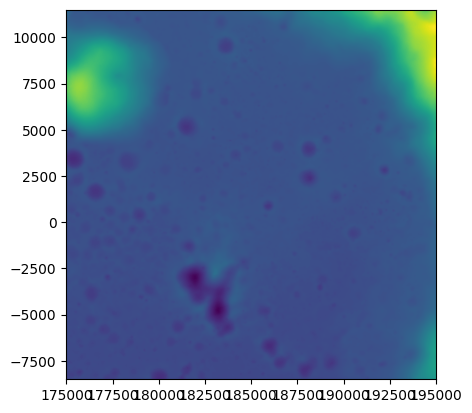

In [6]:
import rasterio
with rasterio.open('NPB_final_adj_5mpp_surf.tif') as src:
    rasterio.plot.show(src)

We can output a similar color-coded height using gdal color-relief. It needs a file to specify the colors. We will use the file in config/lola_colors that covers the range of the PGDA78 dataset.

0...10...20...30...40...50...60...70...80...90...100 - done.


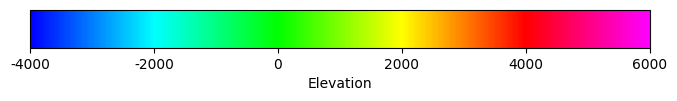

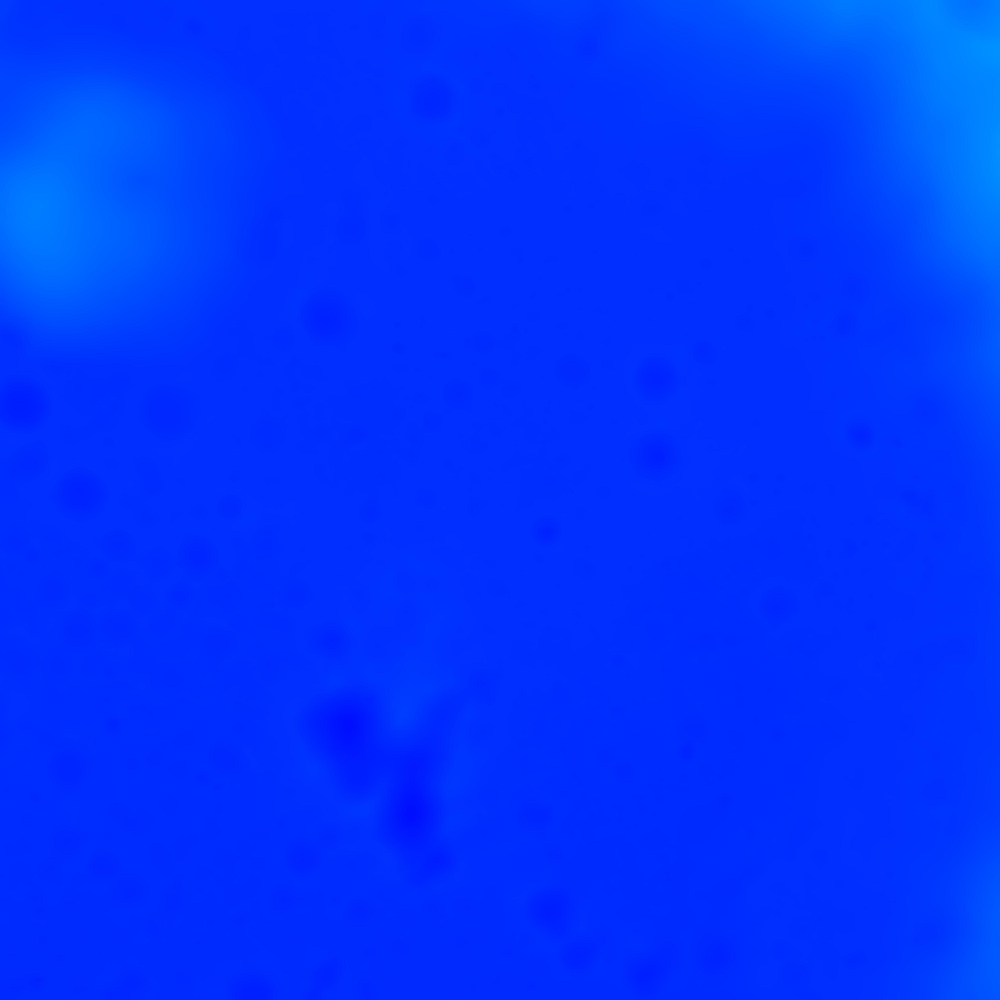

In [2]:
!gdaldem color-relief NPB_final_adj_5mpp_surf.tif ../../config/lola_colors.txt NPB_final_adj_5mpp_surf_colored.png
display(Image.open('../../config/lola_colors.png'))
display(Image.open('NPB_final_adj_5mpp_surf_colored.png'))

It will show an image with the color-coded height. based on the provided color file.

We can use gdal to create a `hillshade` of the file. It will render the terrain based on the slope to recreate locally the sun. This visuazlization is useful to see the topography of the terrain.

0...10...20...30...40...50...60...70...80...90...100 - done.


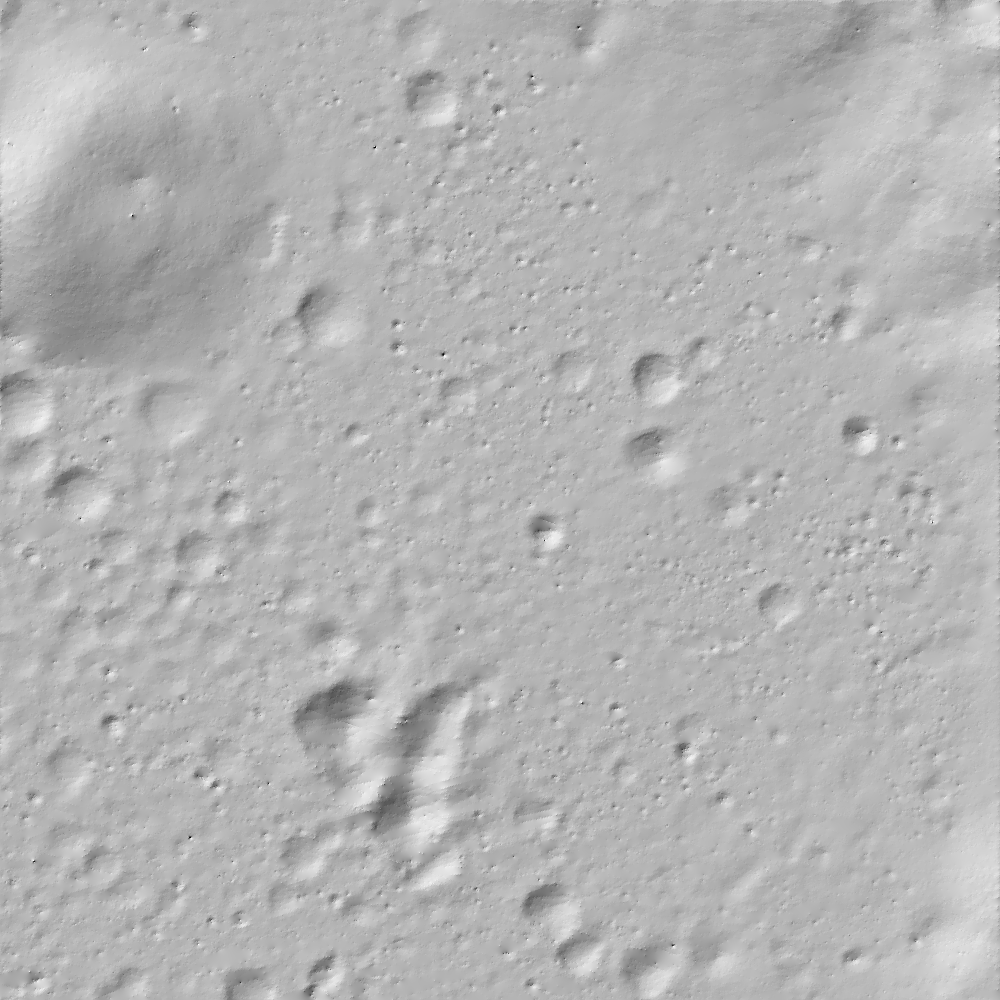

In [20]:
!gdaldem hillshade NPB_final_adj_5mpp_surf.tif NPB_final_adj_5mpp_surf_hillshade.png
display(Image.open('NPB_final_adj_5mpp_surf_hillshade.png'))

The color-refief only modifies the hue, and the hillshade will only change the brightness. We can combine both to get a better visualization of the data. After generating the hillshade and color-relief images, we can combine them using the following code

10172.47s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


0...10...20...30...40...50...60...70...80...90...100 - done.


10178.01s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Blended image saved to NPB_final_adj_5mpp_surf_hillshade_blended.tif


10184.23s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Input file size is 4000, 4000
0...10...20...30...40...50...60...70...80...90...100 - done.


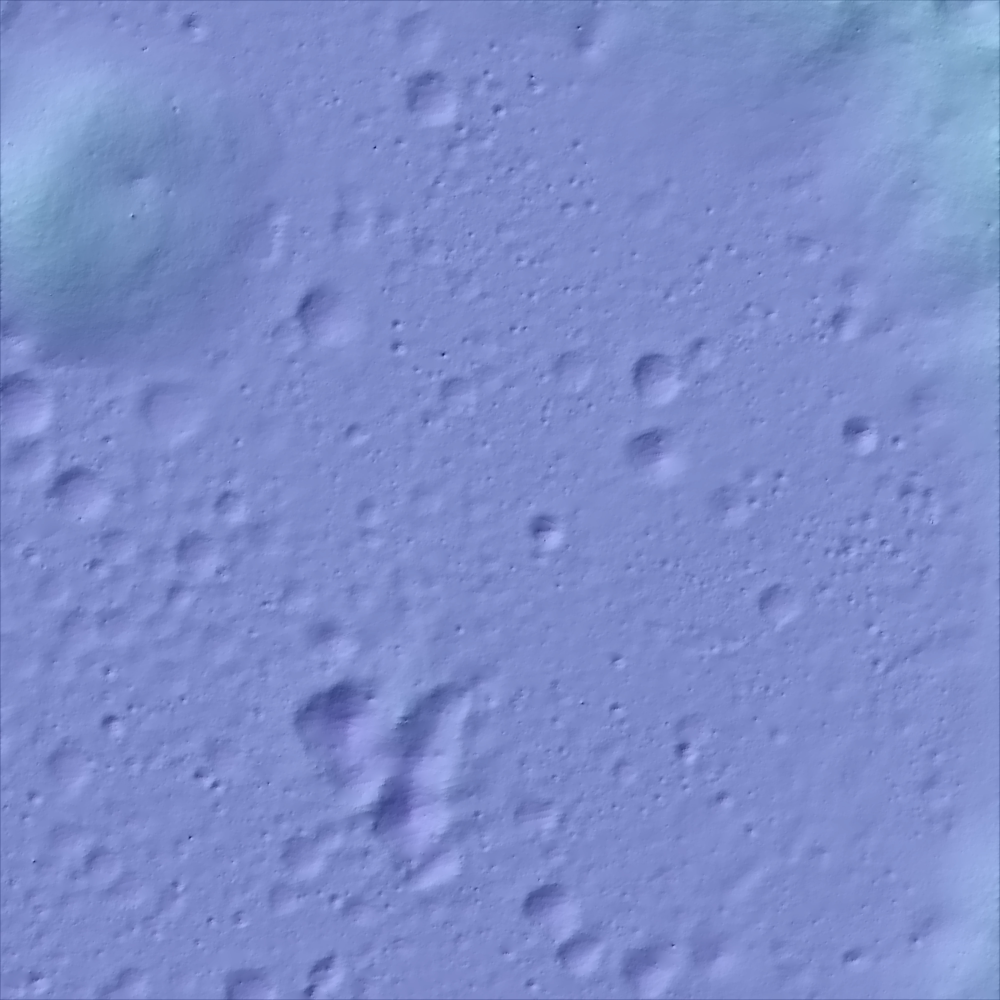

In [23]:
!gdaldem color-relief NPB_final_adj_5mpp_surf.tif ../../config/lola_colors.txt NPB_final_adj_5mpp_surf_colored.tif
!python ../../src/data_tools/combine_tifs.py --tif1 NPB_final_adj_5mpp_surf_hillshade.tif --tif2 NPB_final_adj_5mpp_surf_colored.tif  --alpha 0.7
!gdal_translate -of PNG NPB_final_adj_5mpp_surf_hillshade_blended.tif NPB_final_adj_5mpp_surf_hillshade_colored.png
display(Image.open('NPB_final_adj_5mpp_surf_hillshade_colored.png'))


Note that these commands are meant to be run in the terminal, like in the script `gdal_create.sh`. You can import the methods in your python code if you want to use them inside a bigger python application.

## DEM Slope
Another useful view is the `slope` view. It will show the slope of the terrain. It cannot export to png directly, but we can use the `gdal_translate` command to convert it to a png file.

12347.49s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


0...10...20...30...40...50...60...70...80...90...100 - done.


12353.22s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Input file size is 4000, 4000
Warning 6: PNG driver doesn't support data type Float32. Only eight bit (Byte) and sixteen bit (UInt16) bands supported. Defaulting to Byte

0...10...20...30...40...50...60...70...80...90...100 - done.


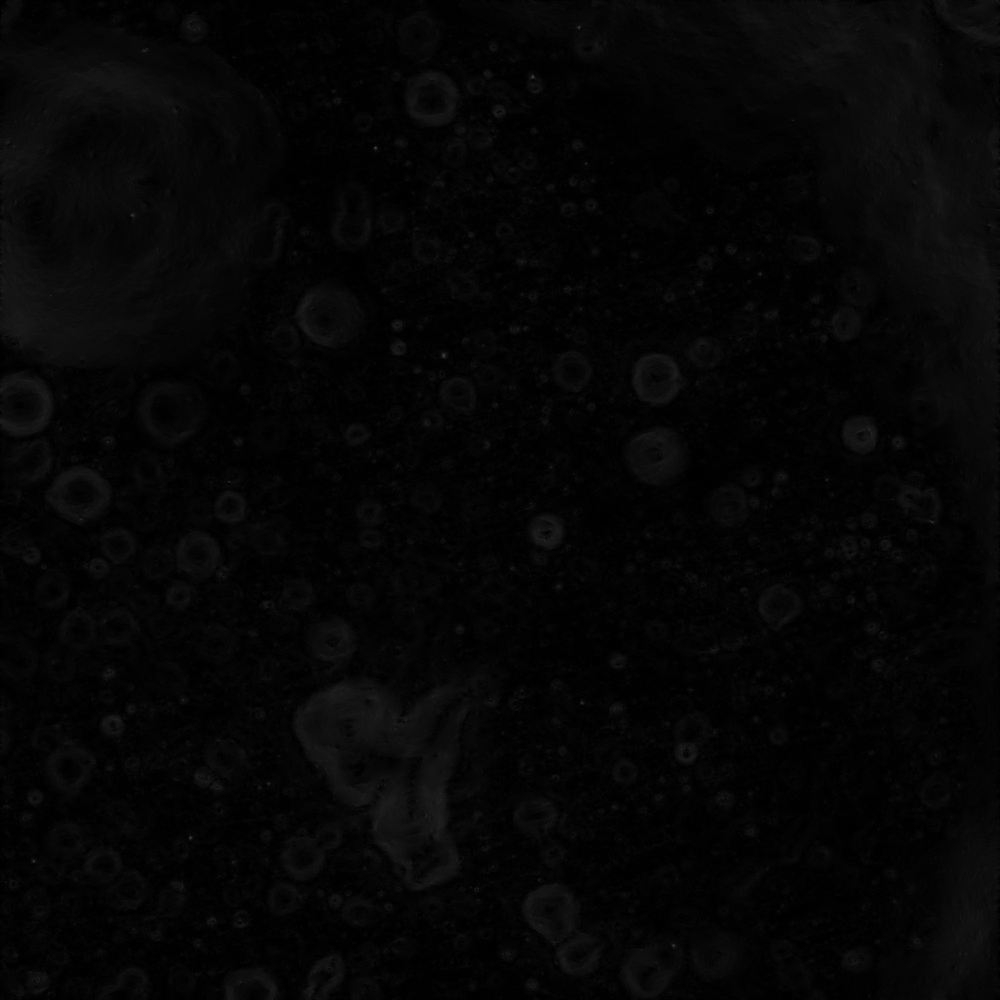

In [68]:
!gdaldem slope NPB_final_adj_5mpp_surf.tif NPB_final_adj_5mpp_surf_slope.tif
!gdal_translate -of PNG NPB_final_adj_5mpp_surf_slope.tif NPB_final_adj_5mpp_surf_slope.png
display(Image.open('NPB_final_adj_5mpp_surf_slope.png'))

The slope maps is normally very dark, so we can use the `convert` command from ImageMagick to increase the contrast. I manually found that a contrast of 80 is good for the slope maps, but you can adjust it to your needs.

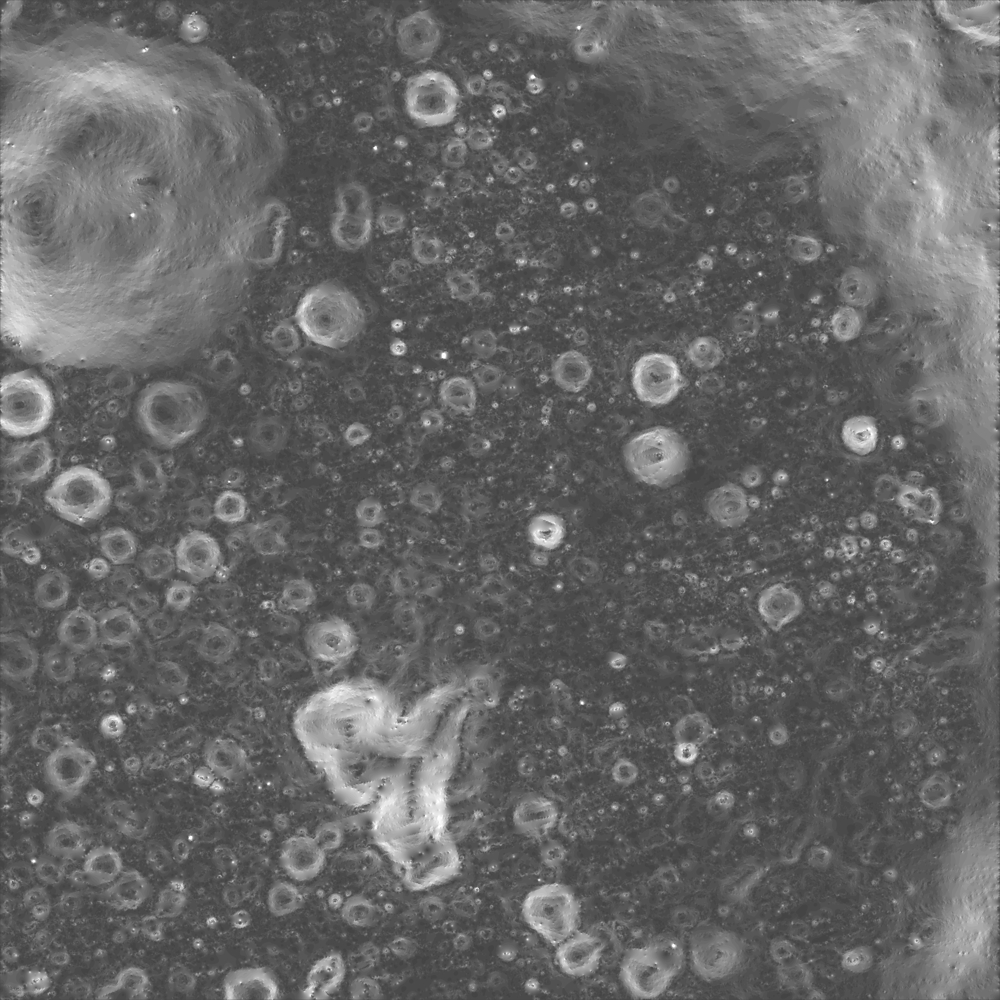

In [26]:
!convert -brightness-contrast 80x80 NPB_final_adj_5mpp_surf_slope.png NPB_final_adj_5mpp_surf_slope_bright.png
display(Image.open('NPB_final_adj_5mpp_surf_slope_bright.png'))

By default it will output a file with the same size of the original image. If we need a smaller image for a thumbmail, we can use the `convert` command from ImageMagick to resize the image.

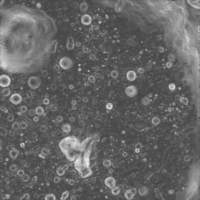

In [28]:
!convert -resize 200x NPB_final_adj_5mpp_surf_slope_bright.png NPB_final_adj_5mpp_surf_slope_bright_small.png
display(Image.open('NPB_final_adj_5mpp_surf_slope_bright_small.png'))

## DEM Latitute, longtitude, and sun position
We can use the metadate in the GeoTiff to compute the latitude and longitude. 

In [2]:
import math
from lunasynth import dem_tools
lat, long = dem_tools.DEM("NPB_final_adj_5mpp_surf.tif").get_latlong()
lat_str, long_str = dem_tools.latlong_rad_to_strings(lat, long)
print(f"latitude {math.degrees(lat):.2f}: {lat_str}, longitude {math.degrees(long):.2f}: {long_str}")

latitude -83.90:83°54'17"S, longitude 89.54:89°32'8"


We can then use the latitude and longitude to compute the sun position for a given time. For example, for normalized noon:

In [7]:
elevation, azimuth = dem_tools.compute_sun_elevation_azimuth(lat,  sun_hour_normalized=0, sun_season=0)
print(f"Noon sun elevation: {math.degrees(elevation):.2f}, azimuth: {math.degrees(azimuth):.2f}")

elevation_min, _ = dem_tools.compute_sun_elevation_azimuth(lat,  sun_hour_normalized=0, sun_season=1)
elevation_max, _ = dem_tools.compute_sun_elevation_azimuth(lat,  sun_hour_normalized=0, sun_season=-1)
print(f"Min and max sun elevation: {math.degrees(elevation_min):.2f} degrees, {math.degrees(elevation_max):.2f} degrees")

Noon sun elevation: 6.10, azimuth: -180.00
Min and max sun elevation: 4.56 degrees, 7.64 degrees


To render the image, we can use the script python script `render_geotiff.py`. It will render the GeoTiff image for a given normalized sun hour (-1 for sunrise, 0 for noon and + for sunset), and normalized sun season (-1 for winter, 1 for summer in the north pole, opposite for south pole). With the flat `overlay` it will show a small compass Rose in the corner of the image, with the illumination and north directions. 

Setting up scene using GPU
Could not find blend file assets/materials/moon_shaders.blend
Loading tiff file NPB_final_adj_5mpp_surf.tif as a mesh
Loaded mesh with size 20000.0x20000.0
latitude -83.90, sun_hour [-0.7, 0.0, 0.7], sun_season [-1.0]
Rendering case 1/3: sun_hour -0.7, sun_season -1.0
elevation 3.29, azimuth 17.01, local_azimuth 106.55, long 89.54
Rendering None to NPB_final_adj_5mpp_surf_rendered_sun_hour_-0.7_sun_season_-1.0.png...
Fra:1 Mem:1536.00M (Peak 1536.00M) | Time:00:00.10 | Mem:0.00M, Peak:0.00M | Scene, ViewLayer | Synchronizing object | Terrain
Fra:1 Mem:3702.03M (Peak 3946.17M) | Time:00:00.70 | Mem:0.00M, Peak:0.00M | Scene, ViewLayer | Initializing
Fra:1 Mem:3701.90M (Peak 3946.17M) | Time:00:00.70 | Mem:0.00M, Peak:0.00M | Scene, ViewLayer | Waiting for render to start
Fra:1 Mem:3701.90M (Peak 3946.17M) | Time:00:00.70 | Mem:0.00M, Peak:0.00M | Scene, ViewLayer | Loading render kernels (may take a few minutes the first time)
Fra:1 Mem:3701.90M (Peak 3946.17M

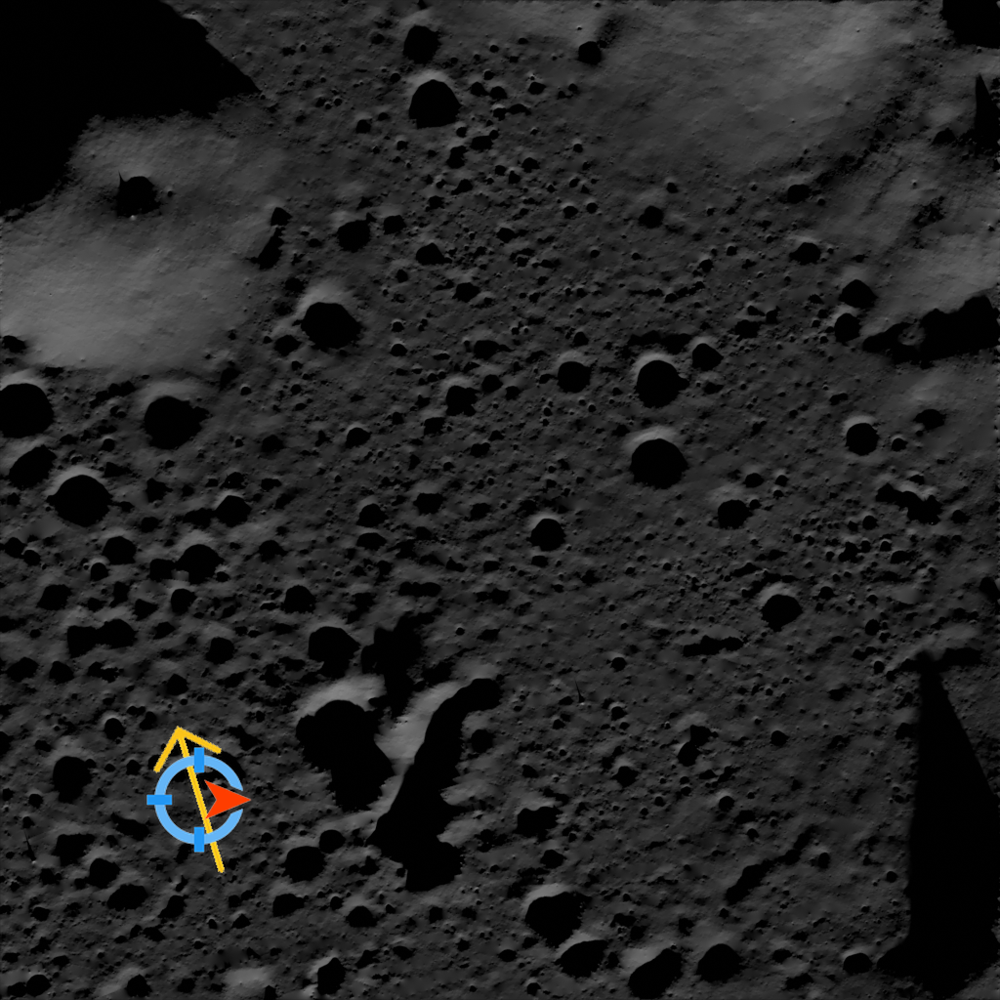

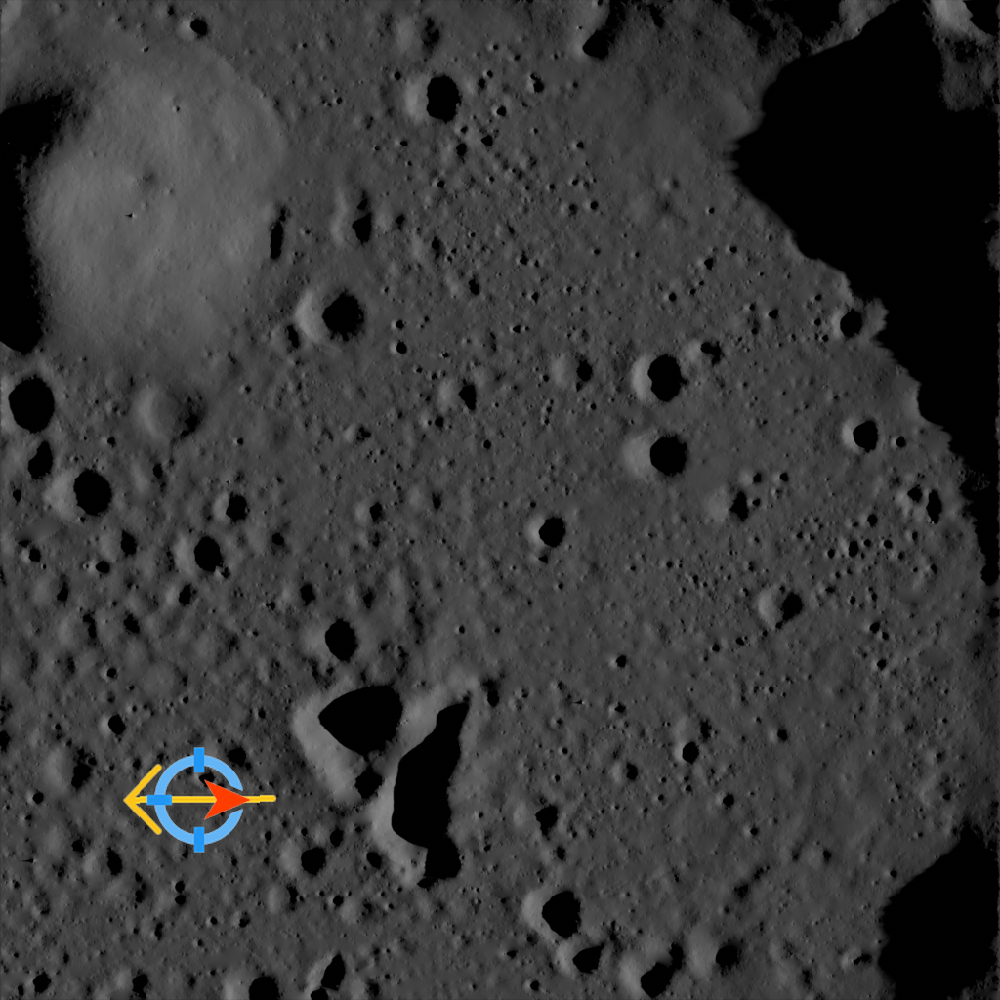

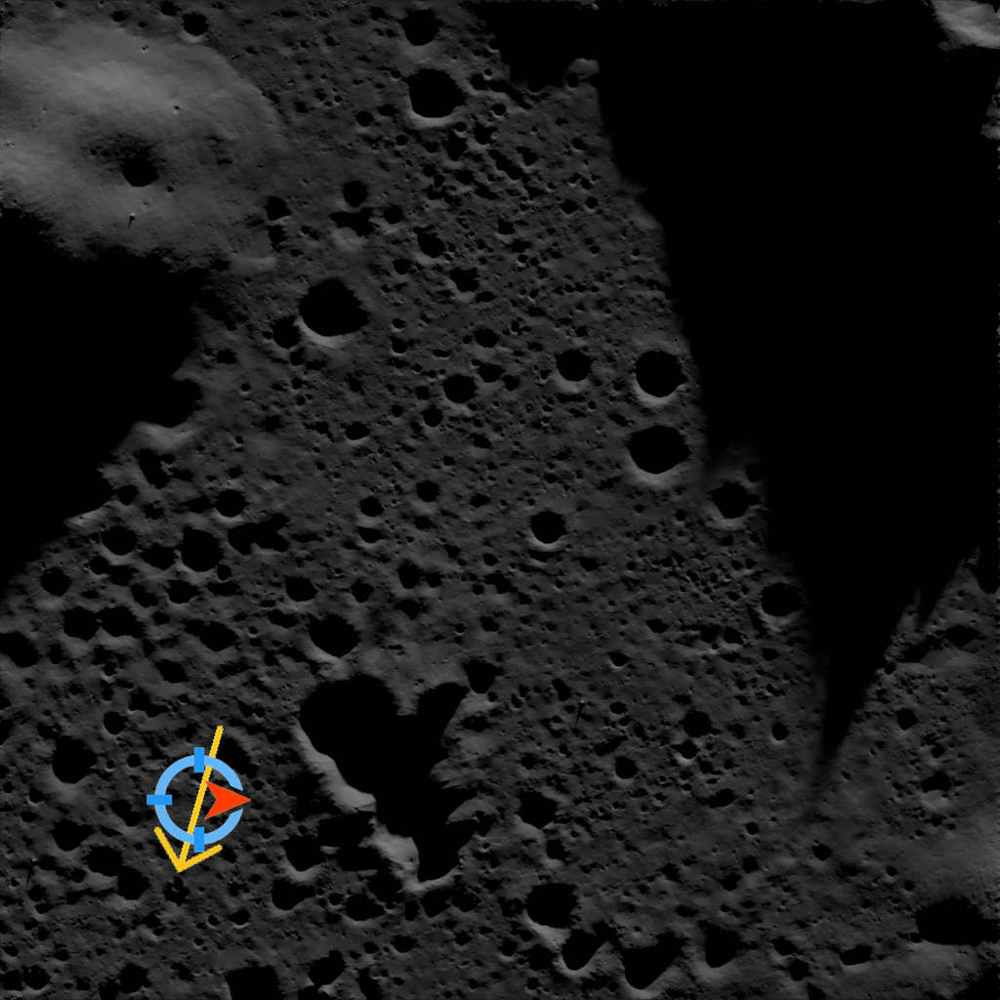

In [12]:
!python ../lunasynth/cli/render_geotiff.py NPB_final_adj_5mpp_surf.tif --sun-hour -0.7 0.0 0.7 --sun-season -1.0 --overlay --save-blender-file
display(Image.open('NPB_final_adj_5mpp_surf_rendered_sun_hour_-0.7_sun_season_-1.0.png'))
display(Image.open('NPB_final_adj_5mpp_surf_rendered_sun_hour_0.0_sun_season_-1.0.png'))
display(Image.open('NPB_final_adj_5mpp_surf_rendered_sun_hour_0.7_sun_season_-1.0.png'))

We can test how the GeoTiff is loaded into blender with the script `mesh2blender.py`. It will load the GeoTiff file into blender, and create a plane elevation map of the file. 

In [17]:
!python ../lunasynth/cli/mesh2blender.py NPB_final_adj_5mpp_surf.tif --output NPB_final_adj_5mpp_surf.blend

Loading tiff file NPB_final_adj_5mpp_surf.tif as a mesh
Loaded mesh with size 20000.0x20000.0
Saving blender file to NPB_final_adj_5mpp_surf.blend
Info: Total files 0 | Changed 0 | Failed 0
Info: Saved "NPB_final_adj_5mpp_surf.blend"


Open the file with blender and take a look!

In [18]:
!blender NPB_final_adj_5mpp_surf.blend

Read prefs: "/home/dpastorm/.config/blender/4.1/config/userpref.blend"
Traceback (most recent call last):
  File "/snap/blender/4697/4.1/scripts/modules/addon_utils.py", line 376, in enable
    mod = importlib.import_module(module_name)
          ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/snap/blender/4697/4.1/python/lib/python3.11/importlib/__init__.py", line 126, in import_module
    return _bootstrap._gcd_import(name[level:], package, level)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "<frozen importlib._bootstrap>", line 1204, in _gcd_import
  File "<frozen importlib._bootstrap>", line 1176, in _find_and_load
  File "<frozen importlib._bootstrap>", line 1147, in _find_and_load_unlocked
  File "<frozen importlib._bootstrap>", line 690, in _load_unlocked
  File "<frozen importlib._bootstrap_external>", line 940, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/home/dpastorm/.config/blender/4.1/scripts

## Cutting the DEM

Some applications with high detail cannot handle the full size of normal DEMs (~20km). We can cut it in smaller pieces using the function `cut_raster_into_pieces`. It will cut the raster into smaller pieces of the specified size. For convenience, the CLI script `cut_tiff.py` exposes this function to the terminal. For example, to cut our DEM into 4km x 4km pieces, we can use the following command:

In [24]:
!python ../data_tools/cut_tiff.py NPB_final_adj_5mpp_surf.tif cut_tif --piece_size_km 4

10215.63s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Cutting the raster into 4.0 km x 4.0 km pieces
Cutting the raster into 5 x 5 pieces


Check that the output tiff has the right size and metadata with gdalinfo.

In [25]:
!gdalinfo cut_tif/NPB_final_adj_5mpp_surf_piece_0_0.tif

10240.48s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Driver: GTiff/GeoTIFF
Files: cut_tif/NPB_final_adj_5mpp_surf_piece_0_0.tif
Size is 800, 800
Coordinate System is:
PROJCRS["unknown",
    BASEGEOGCRS["unknown",
        DATUM["unknown",
            ELLIPSOID["unknown",1737400,0,
                LENGTHUNIT["metre",1,
                    ID["EPSG",9001]]]],
        PRIMEM["Reference meridian",0,
            ANGLEUNIT["degree",0.0174532925199433,
                ID["EPSG",9122]]]],
    CONVERSION["Polar Stereographic (variant A)",
        METHOD["Polar Stereographic (variant A)",
            ID["EPSG",9810]],
        PARAMETER["Latitude of natural origin",-90,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8801]],
        PARAMETER["Longitude of natural origin",0,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8802]],
        PARAMETER["Scale factor at natural origin",1,
            SCALEUNIT["unity",1],
            ID["EPSG",8805]],
        PARAMETER["False easting",0,
            LENG

To cut multiple pieces into multiple sizes we can use the code:

In [ ]:
import os
from pathlib import Path
from data_tools.cut_tiff import cut_raster_into_pieces

data_dir = Path("../../moon_data/new_pgda78")
raw_tiffs_dir = data_dir / "raw_tifs"

sizes_target = [1, 2, 5]

def size_km_to_str(size_km):
    if size_km < 1:
        return f"{size_km * 1000:.0f}m"
    return f"{size_km}km"

for size in sizes_target:
    size_str = size_km_to_str(size)
    print(size_str)

for tiff_file in os.listdir(raw_tiffs_dir):
    print(tiff_file)

for tiff_file in os.listdir(raw_tiffs_dir):
    os.makedirs(data_dir / Path(tiff_file).stem , exist_ok=True)
    for size in sizes_target:
        os.makedirs( data_dir / Path(tiff_file).stem / f"pieces_{size_km_to_str(size)}", exist_ok=True)
        cut_raster_into_pieces(raw_tiffs_dir / Path(tiff_file), data_dir / Path(tiff_file).stem / f"pieces_{size_km_to_str(size)}", size)

## Interpolate DEM
Another common operation is to interpolate the DEM to a higher resolution. We can use scipy.zoom to interpolate the DEM. For example, to interpolate the DEM by a factor of 6, we can use the following code:

In [ ]:
import rasterio
from rasterio.enums import Resampling
factor = 6
with rasterio.open("NPB_final_adj_5mpp_surf.tif") as src:
    data = src.read(
        out_shape=(src.count, int(src.height * factor), int(src.width * factor)),
        resampling=Resampling.bilinear,
    )

    transform = src.transform * src.transform.scale(
        (src.width / data.shape[-1]), (src.height / data.shape[-2])
    )

    profile = src.profile
    profile.update(
        {"height": data.shape[1], "width": data.shape[2], "transform": transform}
    )

    with rasterio.open("NPB_final_adj_5mpp_surf_interpolated.tif", "w", **profile) as dst:
        dst.write(data)

For convenience, the CLI script `interpolate_tiff.py` exposes this function to the terminal. For example, to interpolate our DEM by a factor of 6, we can use the following command:

In [74]:
!python ../data_tools/interpolate_geotiff.py NPB_final_adj_5mpp_surf.tif NPB_final_adj_5mpp_surf_interpolated.tif --factor 6
print("Original and interpolated sizes:")
!gdalinfo NPB_final_adj_5mpp_surf.tif | grep -E "Pixel|Size"
!gdalinfo NPB_final_adj_5mpp_surf_interpolated.tif | grep -E "Pixel|Size"

Original and interpolated sizes:


12675.11s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Size is 4000, 4000
Pixel Size = (5.000000000000000,-5.000000000000000)


12680.40s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Size is 24000, 24000
Pixel Size = (0.833333333333333,-0.833333333333333)


# 3D Models

There are 2 types of 3D models in the Lunasynth project. 
- procedurarly generated models, like using the 'rock' addon in Blender
- scanned using photogrammetry
This notebook will cover how to process and validate the 3d models for usage in the project.

One of the sources of 3D models is the [Apollo Rock Catalog](). It is reconmmend to go to the website and check the models. You can download the models from the website one by one, but for convenience, you can use the script `download_apollo_rocks.py` to download all the models at once. First, get the json file with the catalog information 

In [76]:
import requests
import json
apollo_rock_metadata = requests.get(
    "https://ares.jsc.nasa.gov/astromaterials3d/explorer/lunar_sample_metadata.json"
).json()
print(json.dumps(apollo_rock_metadata, indent=4, sort_keys=True))


{
    "10017-15": {
        "classification": "High-Ti, High-K Ilmenite Basalt",
        "collected": "LM Site, Mare Tranquilitatis, Apollo 11",
        "curation_details": "The rock shown in the above model and video is a subsample of 10017's original parent rock that was picked up on the Moon. Every subsample that is broken or cut from the original parent rock is provided with a child number, which is indicated by a number greater than zero that directly follows the parent name and a comma. The child rock modeled above is therefore specifically identified as Lunar Sample 10017,15. Rocks are subsampled for proposal-approved scientific research, education, and outreach, and is part of normal curation practices for NASA's astromaterials collections. You can learn more about the curation details, bulk chemical composition, and the scientific research that has been published to date on 10017's curation page.",
        "curation_url": "https://curator.jsc.nasa.gov/lunar/samplecatalog/sampl

Code in the script `creat_apollo_rock_catalog.py` will create a table with the main properties of the rocks, and export it in html format. Run the next cell to see the table in firefox

In [78]:
!firefox ../../docs/rock_table.html # change firefox to your other browser if you want to open the file

13276.51s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


There is a collection of rocks To download all the apollo rocks, use script `download_apollo_rocks.py`.

You can use script `create_rock_catalog.py` for a quick overview of the rocks in a given folder. For example, for the earth_scanned rocks:

In [15]:
import trimesh
import pandas as pd
import os


def get_mesh_info(mesh_path):
    # Load the mesh from file
    mesh = trimesh.load(mesh_path, force="mesh")

    # Gather mesh information
    info = {
        "File Name": os.path.basename(mesh_path),
        "File Size (KB)": os.path.getsize(mesh_path) / 1024,
        "Number of Vertices": len(mesh.vertices),
        "Number of Faces": len(mesh.faces),
        "Max cube lenght (m)": mesh.bounding_box_oriented.primitive.extents.max(),
        "Mesh Volume (if solid)": mesh.volume if mesh.is_watertight else "Not a solid",
        "Surface Area": mesh.area,
    }
    return info
    

# List to store mesh info dictionaries
mesh_infos = []

# lis
mesh_folder = "../../assets/rocks/earth_scanned"
mesh_files = os.listdir(mesh_folder)
mesh_files = [os.path.join(mesh_folder, f) for f in mesh_files if f.endswith(".ply")]

# Process each mesh file
for mesh_file in mesh_files:
    mesh_info = get_mesh_info(mesh_file)
    mesh_infos.append(mesh_info)

# Create a DataFrame from the list of dictionaries
df = pd.DataFrame(mesh_infos)

# Print the DataFrame

# save to markdown table, format floats to 2 decimal places
markdown_table = df.to_markdown(floatfmt=".2f", index=False)
print(markdown_table)

| File Name   |   File Size (KB) |   Number of Vertices |   Number of Faces |   Max cube lenght (m) | Mesh Volume (if solid)   |   Surface Area |
|:------------|-----------------:|---------------------:|------------------:|----------------------:|:-------------------------|---------------:|
| rock1.ply   |           135.77 |                 3502 |              7000 |                  1.06 | 0.3023605435278781       |           2.97 |
| rock12.ply  |           152.33 |                 4001 |              7999 |                  0.91 | Not a solid              |           2.26 |
| rock3.ply   |            95.79 |                 2500 |              5000 |                  1.00 | 0.2315599605720109       |           2.42 |
| rock8.ply   |           150.53 |                 4002 |              8000 |                  1.02 | 0.3924023302187801       |           3.27 |
| rock10.ply  |          1861.08 |                50002 |            100000 |                  1.12 | 0.27972742931704053   

Most scripts use trimesh to open and modify the mesh. For example, `save_render_image_mesh.py`, run the code below to have an interactive view of the mesh. In practice, use Meshlab to visualize the mesh.


In [28]:
import trimesh 
import numpy as np

mesh = trimesh.load("../../assets/rocks/earth_scanned/rock1.ply", force="mesh")
# show it
mesh.show()

To use the script from the terminal simply run

10868.04s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Render saved to '../../assets/rocks/earth_scanned/rock1.png'


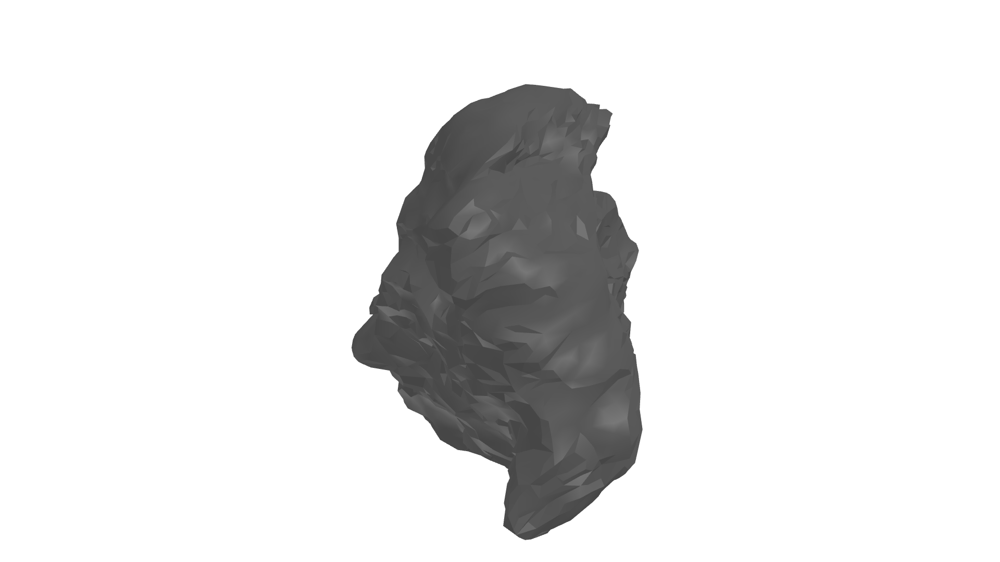

In [32]:
!python ../data_tools/save_render_image_mesh.py ../../assets/rocks/earth_scanned/rock1.ply
display(Image.open('../../assets/rocks/earth_scanned/rock1.png'))

The script `scale_mesh` is used to scale the mesh to a given size. This is required to then scale back the mesh for building the rock field at the size. In addition, it also requires the mesh to be centered at the origin. We can show the bounding box on the previous mesh to show how it works

In [40]:
print(f"Mesh bounding box extents {mesh.bounding_box_oriented.extents}")
print(f"Mesh volume {mesh.volume}")

Mesh bounding box extents [1.05542667 1.21684137 1.05751605]
Mesh volume 0.3023605435278781


In [66]:
scene = trimesh.scene.scene.Scene()
new_bounding_object = mesh.bounding_box_oriented
new_bounding_object.visual.face_colors = [0, 1, 1, 0.3]
scene.add_geometry(new_bounding_object)
scene.add_geometry(mesh)
axis = trimesh.creation.axis(axis_length=1.0)
scene.show()

In [67]:
# transparency does not work inside jupyter notebooks, see the output with the flag --show
!python ../data_tools/scale_mesh.py ../../assets/rocks/earth_scanned/rock2.ply --scale 3.0 --show --output-dir tmp/

11850.01s - pydevd: Sending message related to process being replaced timed-out after 5 seconds


Mesh loaded from ../../assets/rocks/earth_scanned/rock2.ply, fit to scale 3.0 with bounding box type cube
Mesh size is 0.9744056761264801, Scaling factor: 1.0262665997341724
OBB extents: [1.11538035 0.8486629  0.95784755]
Smallest axis index: 1
Traceback (most recent call last):
  File "/home/dpastorm/Projects/lunamaps/lunasynth/src/tutorials/../data_tools/scale_mesh.py", line 188, in <module>
    main()
  File "/home/dpastorm/Projects/lunamaps/lunasynth/src/tutorials/../data_tools/scale_mesh.py", line 175, in main
    scale_mesh(
  File "/home/dpastorm/Projects/lunamaps/lunasynth/src/tutorials/../data_tools/scale_mesh.py", line 114, in scale_mesh
    mesh.export(output_file)
  File "/home/dpastorm/.cache/pypoetry/virtualenvs/lunasynth-iWrNs-qi-py3.11/lib/python3.11/site-packages/trimesh/base.py", line 2820, in export
    return export_mesh(mesh=self, file_obj=file_obj, file_type=file_type, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  